# Instalación de librerias

In [6]:
import spacy
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
import re 
import math
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.naive_bayes import MultinomialNB

# Cargar del Corpus

In [7]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [8]:
!ls "/content/drive/My Drive/Colab Notebooks"

'Copia de ClaseVectorizacionTextos.ipynb'     'PRC DATA BREACH.xlsx'
 DATA.csv				      'Prepocesado de Datos.ipynb'
 datos.csv				       PrimeraPruebaConcepto.ipynb
 DATOS-TC1-GVIS.xlsx			       Programa_01.ipynb
 Matplotlib.ipynb			       Programa_02.ipynb
 PipelineLimpieza-Encoder-Clasificador.ipynb


In [9]:
data = pd.read_excel("/content/drive/My Drive/Colab Notebooks/DATOS-TC1-GVIS.xlsx",sheet_name="DATA")
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19700 entries, 0 to 19699
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Date Made Public         19498 non-null  object 
 1   Company                  15039 non-null  object 
 2   City                     9309 non-null   object 
 3   State                    12412 non-null  object 
 4   Type of breach           10383 non-null  object 
 5   INCIBE TAXONOMY          10383 non-null  object 
 6   Type of organization     10453 non-null  object 
 7   Total Records            9336 non-null   object 
 8   Description of incident  9143 non-null   object 
 9   Information Source       4288 non-null   object 
 10  Source URL               357 non-null    object 
 11  Year of Breach           4289 non-null   float64
 12  Latitude                 4287 non-null   float64
 13  Longitude                4286 non-null   float64
 14  Column1               

In [ ]:
data.head()

,Date Made Public,Company,City,State,Type of breach,INCIBE TAXONOMY,Type of organization,Total Records,Description of incident,Information Source,Source URL,Year of Breach,Latitude,Longitude,Column1,_1,_2
0,3/3/2006,PayDay OK LLC,NaN,New Jersey,HACK,HC,BSF,88,The company's website was breached sometime ar...,California Attorney General,https://oag.ca.gov/,2006.0,40058324.0,-74405661.0,NaN,NaN,NaN
1,1/4/2012,"SF Fire Credit Union, Pacifica-Coastside Credi...",San Francisco,California,PORT,DL1,BSF,0,"The December 29, 2011 theft of a laptop from a...",California Attorney General,NaN,2012.0,3777493.0,-122419416.0,NaN,NaN,NaN
2,2/18/2012,"BDO USA, Rubio's Restaurants, Inc.",San Diego,California,PORT,DL1,BSR,0,BDO was contracted by Rubio's to perform finan...,California Attorney General,NaN,2012.0,32715329.0,-117157255.0,NaN,NaN,NaN
3,2/22/2012,"DHI Mortgage Company, Ltd.",Austin,Texas,HACK,HC,BSF,0,"On February 10, 2012, DHI Mortgage became awar...",California Attorney General,NaN,2012.0,30267153.0,-97743061.0,NaN,NaN,NaN
4,3/12/2012,"Impairment Resources, LLC",San Diego,California,PORT,DL1,MED,"14,000",An office burglary on New Year's Eve 2011 resu...,California Attorney General,NaN,2012.0,32715329.0,-117157255.0,NaN,NaN,NaN


In [10]:
data1 = pd.read_excel("/content/drive/My Drive/Colab Notebooks/DATOS-TC1-GVIS.xlsx",sheet_name="DATA-LABEL")
#data1.info()
# Configuraremos Pandas para que no nos trunque los textos cuando los imprime
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)
# Ahora veremos el encabezado del dataset
data1.head()

,Description of incident,INCIBE TAXONOMY
0,"The company's website was breached sometime around February 19 by a hacker in an attempt to gain access to certain customers' private information. Social Security numbers, names, addresses, bank account names and bank account numbers may have been compromised. At least 88 individuals were affected.",HC
1,"The December 29, 2011 theft of a laptop from a parked car in San Francisco resulted in the loss of personal information. The information was being used in preparation for a merger between SF Fire Credit Union and Pacifica-Coastside Credit Union. Current and former account holders had their names, Social Security numbers, dates of birth, addresses, and Pacifica-Coastside Credit Union account information.",DL
2,"BDO was contracted by Rubio's to perform financial auditing services. A BDO employee accidentally removed one or more CD-ROMs from the office. The CD-ROM or CD-ROMs contained a list of Rubio's workers' compensation claimants and a list of people who owned equity shares in Rubio's Restaurants, Inc. The CD-ROM or CD-ROMS appear to have been stolen from the BDO employee's vehicle. The workers' compensation information contained names, claim numbers, medical status, and date of loss. The medical status information included the employees' claim for injuries or illnesses. No Social Security numbers were involved. The partial equity roll list contained names and Social Security numbers.",DL
3,"On February 10, 2012, DHI Mortgage became aware that a software security breach by external sources had occurred in its Internet Loan Prequalification System. DHI Mortgage immediately isolated the affected server, purged certain affected files, and modified the electronic security measures. People who provided their information online for pre-qualification may have had their names, Social Security numbers, dates of birth, contact information, marital status, employment information, income, asset information, and liability information exposed.",HC
4,"An office burglary on New Year's Eve 2011 resulted in the loss of hardware that contained sensitive personal information. The full names, addresses, Social Security numbers, and medical information of clients were on the hardware. Impairment Resources notified patients in February and then filed for bankruptcy in March. The high cost of handling the breach led directly to the decision to file for bankruptcy.",DL


In [11]:
#comparación de dimensión de los dataset data = original, data1 = descripción y etiqueta
size_data = len(data)
size_data1= len(data1)
print(size_data)
print(size_data1)

19700
19322


In [12]:
df1 = data1[['Description of incident','INCIBE TAXONOMY']]

In [13]:
df2 = df1.dropna(axis='index',how='any') 

In [14]:
print(len(df1))
print(len(df2))

19322
8972


In [15]:
df2.head()

,Description of incident,INCIBE TAXONOMY
0,"The company's website was breached sometime around February 19 by a hacker in an attempt to gain access to certain customers' private information. Social Security numbers, names, addresses, bank account names and bank account numbers may have been compromised. At least 88 individuals were affected.",HC
1,"The December 29, 2011 theft of a laptop from a parked car in San Francisco resulted in the loss of personal information. The information was being used in preparation for a merger between SF Fire Credit Union and Pacifica-Coastside Credit Union. Current and former account holders had their names, Social Security numbers, dates of birth, addresses, and Pacifica-Coastside Credit Union account information.",DL
2,"BDO was contracted by Rubio's to perform financial auditing services. A BDO employee accidentally removed one or more CD-ROMs from the office. The CD-ROM or CD-ROMs contained a list of Rubio's workers' compensation claimants and a list of people who owned equity shares in Rubio's Restaurants, Inc. The CD-ROM or CD-ROMS appear to have been stolen from the BDO employee's vehicle. The workers' compensation information contained names, claim numbers, medical status, and date of loss. The medical status information included the employees' claim for injuries or illnesses. No Social Security numbers were involved. The partial equity roll list contained names and Social Security numbers.",DL
3,"On February 10, 2012, DHI Mortgage became aware that a software security breach by external sources had occurred in its Internet Loan Prequalification System. DHI Mortgage immediately isolated the affected server, purged certain affected files, and modified the electronic security measures. People who provided their information online for pre-qualification may have had their names, Social Security numbers, dates of birth, contact information, marital status, employment information, income, asset information, and liability information exposed.",HC
4,"An office burglary on New Year's Eve 2011 resulted in the loss of hardware that contained sensitive personal information. The full names, addresses, Social Security numbers, and medical information of clients were on the hardware. Impairment Resources notified patients in February and then filed for bankruptcy in March. The high cost of handling the breach led directly to the decision to file for bankruptcy.",DL


# Pipeline preprocesamiento de texto

In [16]:
df2['Description_lower'] = df2['Description of incident'].str.lower()
df2.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,Description of incident,INCIBE TAXONOMY,Description_lower
0,"The company's website was breached sometime around February 19 by a hacker in an attempt to gain access to certain customers' private information. Social Security numbers, names, addresses, bank account names and bank account numbers may have been compromised. At least 88 individuals were affected.",HC,"the company's website was breached sometime around february 19 by a hacker in an attempt to gain access to certain customers' private information. social security numbers, names, addresses, bank account names and bank account numbers may have been compromised. at least 88 individuals were affected."
1,"The December 29, 2011 theft of a laptop from a parked car in San Francisco resulted in the loss of personal information. The information was being used in preparation for a merger between SF Fire Credit Union and Pacifica-Coastside Credit Union. Current and former account holders had their names, Social Security numbers, dates of birth, addresses, and Pacifica-Coastside Credit Union account information.",DL,"the december 29, 2011 theft of a laptop from a parked car in san francisco resulted in the loss of personal information. the information was being used in preparation for a merger between sf fire credit union and pacifica-coastside credit union. current and former account holders had their names, social security numbers, dates of birth, addresses, and pacifica-coastside credit union account information."
2,"BDO was contracted by Rubio's to perform financial auditing services. A BDO employee accidentally removed one or more CD-ROMs from the office. The CD-ROM or CD-ROMs contained a list of Rubio's workers' compensation claimants and a list of people who owned equity shares in Rubio's Restaurants, Inc. The CD-ROM or CD-ROMS appear to have been stolen from the BDO employee's vehicle. The workers' compensation information contained names, claim numbers, medical status, and date of loss. The medical status information included the employees' claim for injuries or illnesses. No Social Security numbers were involved. The partial equity roll list contained names and Social Security numbers.",DL,"bdo was contracted by rubio's to perform financial auditing services. a bdo employee accidentally removed one or more cd-roms from the office. the cd-rom or cd-roms contained a list of rubio's workers' compensation claimants and a list of people who owned equity shares in rubio's restaurants, inc. the cd-rom or cd-roms appear to have been stolen from the bdo employee's vehicle. the workers' compensation information contained names, claim numbers, medical status, and date of loss. the medical status information included the employees' claim for injuries or illnesses. no social security numbers were involved. the partial equity roll list contained names and social security numbers."
3,"On February 10, 2012, DHI Mortgage became aware that a software security breach by external sources had occurred in its Internet Loan Prequalification System. DHI Mortgage immediately isolated the affected server, purged certain affected files, and modified the electronic security measures. People who provided their information online for pre-qualification may have had their names, Social Security numbers, dates of birth, contact information, marital status, employment information, income, asset information, and liability information exposed.",HC,"on february 10, 2012, dhi mortgage became aware that a software security breach by external sources had occurred in its internet loan prequalification system. dhi mortgage immediately isolated the affected server, purged certain affected files, and modified the electronic security measures. people who provided their information online for pre-qualification may have had their names, social security numbers, dates of birth, contact information, marital status, employment information, income, asset information, and liability information exposed."
4,"An office bu

In [17]:
import string
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [18]:
def quitar_puntuacion(txt):
  txt_nopunt= "".join([c for c in txt if c not in string.punctuation])
  return txt_nopunt

In [19]:
df2['description_clean'] = df2['Description_lower'].apply(lambda x: quitar_puntuacion(x))
df2.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,Description of incident,INCIBE TAXONOMY,Description_lower,description_clean
0,"The company's website was breached sometime around February 19 by a hacker in an attempt to gain access to certain customers' private information. Social Security numbers, names, addresses, bank account names and bank account numbers may have been compromised. At least 88 individuals were affected.",HC,"the company's website was breached sometime around february 19 by a hacker in an attempt to gain access to certain customers' private information. social security numbers, names, addresses, bank account names and bank account numbers may have been compromised. at least 88 individuals were affected.",the companys website was breached sometime around february 19 by a hacker in an attempt to gain access to certain customers private information social security numbers names addresses bank account names and bank account numbers may have been compromised at least 88 individuals were affected
1,"The December 29, 2011 theft of a laptop from a parked car in San Francisco resulted in the loss of personal information. The information was being used in preparation for a merger between SF Fire Credit Union and Pacifica-Coastside Credit Union. Current and former account holders had their names, Social Security numbers, dates of birth, addresses, and Pacifica-Coastside Credit Union account information.",DL,"the december 29, 2011 theft of a laptop from a parked car in san francisco resulted in the loss of personal information. the information was being used in preparation for a merger between sf fire credit union and pacifica-coastside credit union. current and former account holders had their names, social security numbers, dates of birth, addresses, and pacifica-coastside credit union account information.",the december 29 2011 theft of a laptop from a parked car in san francisco resulted in the loss of personal information the information was being used in preparation for a merger between sf fire credit union and pacificacoastside credit union current and former account holders had their names social security numbers dates of birth addresses and pacificacoastside credit union account information
2,"BDO was contracted by Rubio's to perform financial auditing services. A BDO employee accidentally removed one or more CD-ROMs from the office. The CD-ROM or CD-ROMs contained a list of Rubio's workers' compensation claimants and a list of people who owned equity shares in Rubio's Restaurants, Inc. The CD-ROM or CD-ROMS appear to have been stolen from the BDO employee's vehicle. The workers' compensation information contained names, claim numbers, medical status, and date of loss. The medical status information included the employees' claim for injuries or illnesses. No Social Security numbers were involved. The partial equity roll list contained names and Social Security numbers.",DL,"bdo was contracted by rubio's to perform financial auditing services. a bdo employee accidentally removed one or more cd-roms from the office. the cd-rom or cd-roms contained a list of rubio's workers' compensation claimants and a list of people who owned equity shares in rubio's restaurants, inc. the cd-rom or cd-roms appear to have been stolen from the bdo employee's vehicle. the workers' compensation information contained names, claim numbers, medical status, and date of loss. the medical status information included the employees' claim for injuries or illnesses. no social security numbers were involved. the partial equity roll list contained names and social security numbers.",bdo was contracted by rubios to perform financial auditing services a bdo employee accidentally removed one or more cdroms from the office the cdrom or cdroms contained a list of rubios workers compensation claimants and a list of people who owned equity shares in rubios restaurants inc the cdrom or cdroms appear to have been stolen from the bdo employees vehicle the workers compensation information contained na

In [20]:
def tokenize(txt):
  tokens = re.split('\W+',txt)
  return tokens

In [21]:
df2['data_tokenized'] = df2['description_clean'].apply(lambda x: tokenize(x))
df2.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,Description of incident,INCIBE TAXONOMY,Description_lower,description_clean,data_tokenized
0,"The company's website was breached sometime around February 19 by a hacker in an attempt to gain access to certain customers' private information. Social Security numbers, names, addresses, bank account names and bank account numbers may have been compromised. At least 88 individuals were affected.",HC,"the company's website was breached sometime around february 19 by a hacker in an attempt to gain access to certain customers' private information. social security numbers, names, addresses, bank account names and bank account numbers may have been compromised. at least 88 individuals were affected.",the companys website was breached sometime around february 19 by a hacker in an attempt to gain access to certain customers private information social security numbers names addresses bank account names and bank account numbers may have been compromised at least 88 individuals were affected,"[the, companys, website, was, breached, sometime, around, february, 19, by, a, hacker, in, an, attempt, to, gain, access, to, certain, customers, private, information, social, security, numbers, names, addresses, bank, account, names, and, bank, account, numbers, may, have, been, compromised, at, least, 88, individuals, were, affected]"
1,"The December 29, 2011 theft of a laptop from a parked car in San Francisco resulted in the loss of personal information. The information was being used in preparation for a merger between SF Fire Credit Union and Pacifica-Coastside Credit Union. Current and former account holders had their names, Social Security numbers, dates of birth, addresses, and Pacifica-Coastside Credit Union account information.",DL,"the december 29, 2011 theft of a laptop from a parked car in san francisco resulted in the loss of personal information. the information was being used in preparation for a merger between sf fire credit union and pacifica-coastside credit union. current and former account holders had their names, social security numbers, dates of birth, addresses, and pacifica-coastside credit union account information.",the december 29 2011 theft of a laptop from a parked car in san francisco resulted in the loss of personal information the information was being used in preparation for a merger between sf fire credit union and pacificacoastside credit union current and former account holders had their names social security numbers dates of birth addresses and pacificacoastside credit union account information,"[the, december, 29, 2011, theft, of, a, laptop, from, a, parked, car, in, san, francisco, resulted, in, the, loss, of, personal, information, the, information, was, being, used, in, preparation, for, a, merger, between, sf, fire, credit, union, and, pacificacoastside, credit, union, current, and, former, account, holders, had, their, names, social, security, numbers, dates, of, birth, addresses, and, pacificacoastside, credit, union, account, information]"
2,"BDO was contracted by Rubio's to perform financial auditing services. A BDO employee accidentally removed one or more CD-ROMs from the office. The CD-ROM or CD-ROMs contained a list of Rubio's workers' compensation claimants and a list of people who owned equity shares in Rubio's Restaurants, Inc. The CD-ROM or CD-ROMS appear to have been stolen from the BDO employee's vehicle. The workers' compensation information contained names, claim numbers, medical status, and date of loss. The medical status information included the employees' claim for injuries or illnesses. No Social Security numbers were involved. The partial equity roll list contained names and Social Security numbers.",DL,"bdo was contracted by rubio's to perform financial auditing services. a bdo employee accidentally removed one or more cd-roms from the office. the cd-rom or cd-roms contained a list of rubio's workers' compensation claimants and a list of people who owned equity shares in rubio's restaur

In [22]:
import nltk
nltk.download('stopwords')
stopwords = nltk.corpus.stopwords.words('english')
stopwords[0:10]

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're"]

In [23]:
def quitar_stopwords(txt):
  txt_clean = [word for word in txt if word is not stopwords]
  return txt_clean

df2['Description_no_stpw'] = df2['data_tokenized'].apply(lambda x: quitar_stopwords(x))
df2.head() 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,Description of incident,INCIBE TAXONOMY,Description_lower,description_clean,data_tokenized,Description_no_stpw
0,"The company's website was breached sometime around February 19 by a hacker in an attempt to gain access to certain customers' private information. Social Security numbers, names, addresses, bank account names and bank account numbers may have been compromised. At least 88 individuals were affected.",HC,"the company's website was breached sometime around february 19 by a hacker in an attempt to gain access to certain customers' private information. social security numbers, names, addresses, bank account names and bank account numbers may have been compromised. at least 88 individuals were affected.",the companys website was breached sometime around february 19 by a hacker in an attempt to gain access to certain customers private information social security numbers names addresses bank account names and bank account numbers may have been compromised at least 88 individuals were affected,"[the, companys, website, was, breached, sometime, around, february, 19, by, a, hacker, in, an, attempt, to, gain, access, to, certain, customers, private, information, social, security, numbers, names, addresses, bank, account, names, and, bank, account, numbers, may, have, been, compromised, at, least, 88, individuals, were, affected]","[the, companys, website, was, breached, sometime, around, february, 19, by, a, hacker, in, an, attempt, to, gain, access, to, certain, customers, private, information, social, security, numbers, names, addresses, bank, account, names, and, bank, account, numbers, may, have, been, compromised, at, least, 88, individuals, were, affected]"
1,"The December 29, 2011 theft of a laptop from a parked car in San Francisco resulted in the loss of personal information. The information was being used in preparation for a merger between SF Fire Credit Union and Pacifica-Coastside Credit Union. Current and former account holders had their names, Social Security numbers, dates of birth, addresses, and Pacifica-Coastside Credit Union account information.",DL,"the december 29, 2011 theft of a laptop from a parked car in san francisco resulted in the loss of personal information. the information was being used in preparation for a merger between sf fire credit union and pacifica-coastside credit union. current and former account holders had their names, social security numbers, dates of birth, addresses, and pacifica-coastside credit union account information.",the december 29 2011 theft of a laptop from a parked car in san francisco resulted in the loss of personal information the information was being used in preparation for a merger between sf fire credit union and pacificacoastside credit union current and former account holders had their names social security numbers dates of birth addresses and pacificacoastside credit union account information,"[the, december, 29, 2011, theft, of, a, laptop, from, a, parked, car, in, san, francisco, resulted, in, the, loss, of, personal, information, the, information, was, being, used, in, preparation, for, a, merger, between, sf, fire, credit, union, and, pacificacoastside, credit, union, current, and, former, account, holders, had, their, names, social, security, numbers, dates, of, birth, addresses, and, pacificacoastside, credit, union, account, information]","[the, december, 29, 2011, theft, of, a, laptop, from, a, parked, car, in, san, francisco, resulted, in, the, loss, of, personal, information, the, information, was, being, used, in, preparation, for, a, merger, between, sf, fire, credit, union, and, pacificacoastside, credit, union, current, and, former, account, holders, had, their, names, social, security, numbers, dates, of, birth, addresses, and, pacificacoastside, credit, union, account, information]"
2,"BDO was contracted by Rubio's to perform financial auditing services. A BDO employee accidentally removed one or more CD-ROMs from the office. The CD-ROM or CD-

In [24]:
from nltk.stem import PorterStemmer
ps = PorterStemmer()
dir(ps)

['MARTIN_EXTENSIONS',
 'NLTK_EXTENSIONS',
 'ORIGINAL_ALGORITHM',
 '__abstractmethods__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__unicode__',
 '__weakref__',
 '_abc_impl',
 '_apply_rule_list',
 '_contains_vowel',
 '_ends_cvc',
 '_ends_double_consonant',
 '_has_positive_measure',
 '_is_consonant',
 '_measure',
 '_replace_suffix',
 '_step1a',
 '_step1b',
 '_step1c',
 '_step2',
 '_step3',
 '_step4',
 '_step5a',
 '_step5b',
 'mode',
 'pool',
 'stem',
 'unicode_repr',
 'vowels']

In [25]:
def stemming(txt):
  text = [ps.stem(word) for word in txt]
  return text
df2['Description stemmend'] = df2['Description_no_stpw'].apply(lambda x: stemming(x))
df2.head() 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


,Description of incident,INCIBE TAXONOMY,Description_lower,description_clean,data_tokenized,Description_no_stpw,Description stemmend
0,"The company's website was breached sometime around February 19 by a hacker in an attempt to gain access to certain customers' private information. Social Security numbers, names, addresses, bank account names and bank account numbers may have been compromised. At least 88 individuals were affected.",HC,"the company's website was breached sometime around february 19 by a hacker in an attempt to gain access to certain customers' private information. social security numbers, names, addresses, bank account names and bank account numbers may have been compromised. at least 88 individuals were affected.",the companys website was breached sometime around february 19 by a hacker in an attempt to gain access to certain customers private information social security numbers names addresses bank account names and bank account numbers may have been compromised at least 88 individuals were affected,"[the, companys, website, was, breached, sometime, around, february, 19, by, a, hacker, in, an, attempt, to, gain, access, to, certain, customers, private, information, social, security, numbers, names, addresses, bank, account, names, and, bank, account, numbers, may, have, been, compromised, at, least, 88, individuals, were, affected]","[the, companys, website, was, breached, sometime, around, february, 19, by, a, hacker, in, an, attempt, to, gain, access, to, certain, customers, private, information, social, security, numbers, names, addresses, bank, account, names, and, bank, account, numbers, may, have, been, compromised, at, least, 88, individuals, were, affected]","[the, compani, websit, wa, breach, sometim, around, februari, 19, by, a, hacker, in, an, attempt, to, gain, access, to, certain, custom, privat, inform, social, secur, number, name, address, bank, account, name, and, bank, account, number, may, have, been, compromis, at, least, 88, individu, were, affect]"
1,"The December 29, 2011 theft of a laptop from a parked car in San Francisco resulted in the loss of personal information. The information was being used in preparation for a merger between SF Fire Credit Union and Pacifica-Coastside Credit Union. Current and former account holders had their names, Social Security numbers, dates of birth, addresses, and Pacifica-Coastside Credit Union account information.",DL,"the december 29, 2011 theft of a laptop from a parked car in san francisco resulted in the loss of personal information. the information was being used in preparation for a merger between sf fire credit union and pacifica-coastside credit union. current and former account holders had their names, social security numbers, dates of birth, addresses, and pacifica-coastside credit union account information.",the december 29 2011 theft of a laptop from a parked car in san francisco resulted in the loss of personal information the information was being used in preparation for a merger between sf fire credit union and pacificacoastside credit union current and former account holders had their names social security numbers dates of birth addresses and pacificacoastside credit union account information,"[the, december, 29, 2011, theft, of, a, laptop, from, a, parked, car, in, san, francisco, resulted, in, the, loss, of, personal, information, the, information, was, being, used, in, preparation, for, a, merger, between, sf, fire, credit, union, and, pacificacoastside, credit, union, current, and, former, account, holders, had, their, names, social, security, numbers, dates, of, birth, addresses, and, pacificacoastside, credit, union, account, information]","[the, december, 29, 2011, theft, of, a, laptop, from, a, parked, car, in, san, francisco, resulted, in, the, loss, of, personal, information, the, information, was, being, used, in, preparation, for, a, merger, between, sf, fire, credit, union, and, pacificacoastside, credit, union, current, a

In [26]:
nltk.download('wordnet')
wn = nltk.WordNetLemmatizer()
dir(wn)

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__unicode__',
 '__weakref__',
 'lemmatize',
 'unicode_repr']

In [27]:
def lemmatization(txt):
  text = [wn.lemmatize(word) for word in txt]
  return text
df2['Description lemmatized'] = df2['Description_no_stpw'].apply(lambda x: lemmatization(x))
df2.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


,Description of incident,INCIBE TAXONOMY,Description_lower,description_clean,data_tokenized,Description_no_stpw,Description stemmend,Description lemmatized
0,"The company's website was breached sometime around February 19 by a hacker in an attempt to gain access to certain customers' private information. Social Security numbers, names, addresses, bank account names and bank account numbers may have been compromised. At least 88 individuals were affected.",HC,"the company's website was breached sometime around february 19 by a hacker in an attempt to gain access to certain customers' private information. social security numbers, names, addresses, bank account names and bank account numbers may have been compromised. at least 88 individuals were affected.",the companys website was breached sometime around february 19 by a hacker in an attempt to gain access to certain customers private information social security numbers names addresses bank account names and bank account numbers may have been compromised at least 88 individuals were affected,"[the, companys, website, was, breached, sometime, around, february, 19, by, a, hacker, in, an, attempt, to, gain, access, to, certain, customers, private, information, social, security, numbers, names, addresses, bank, account, names, and, bank, account, numbers, may, have, been, compromised, at, least, 88, individuals, were, affected]","[the, companys, website, was, breached, sometime, around, february, 19, by, a, hacker, in, an, attempt, to, gain, access, to, certain, customers, private, information, social, security, numbers, names, addresses, bank, account, names, and, bank, account, numbers, may, have, been, compromised, at, least, 88, individuals, were, affected]","[the, compani, websit, wa, breach, sometim, around, februari, 19, by, a, hacker, in, an, attempt, to, gain, access, to, certain, custom, privat, inform, social, secur, number, name, address, bank, account, name, and, bank, account, number, may, have, been, compromis, at, least, 88, individu, were, affect]","[the, company, website, wa, breached, sometime, around, february, 19, by, a, hacker, in, an, attempt, to, gain, access, to, certain, customer, private, information, social, security, number, name, address, bank, account, name, and, bank, account, number, may, have, been, compromised, at, least, 88, individual, were, affected]"
1,"The December 29, 2011 theft of a laptop from a parked car in San Francisco resulted in the loss of personal information. The information was being used in preparation for a merger between SF Fire Credit Union and Pacifica-Coastside Credit Union. Current and former account holders had their names, Social Security numbers, dates of birth, addresses, and Pacifica-Coastside Credit Union account information.",DL,"the december 29, 2011 theft of a laptop from a parked car in san francisco resulted in the loss of personal information. the information was being used in preparation for a merger between sf fire credit union and pacifica-coastside credit union. current and former account holders had their names, social security numbers, dates of birth, addresses, and pacifica-coastside credit union account information.",the december 29 2011 theft of a laptop from a parked car in san francisco resulted in the loss of personal information the information was being used in preparation for a merger between sf fire credit union and pacificacoastside credit union current and former account holders had their names social security numbers dates of birth addresses and pacificacoastside credit union account information,"[the, december, 29, 2011, theft, of, a, laptop, from, a, parked, car, in, san, francisco, resulted, in, the, loss, of, personal, information, the, information, was, being, used, in, preparation, for, a, merger, between, sf, fire, credit, union, and, pacificacoastside, credit, union, current, and, former, account, holders, had, their, names, social, security, numbers, dates, of, birth, addresses, and,

# CountVectorizer

In [28]:
def clean_text(txt):
  txt = ''.join([c for c in txt if c not in string.punctuation])
  token1 = re.split('\W+',txt)
  txt = " ".join([ps.stem(word) for word in token1 if word not in stopwords])
  return txt
df2['desp_clean_final'] = df2['Description_lower'].apply(lambda x: clean_text(x))
df3 = df2[['Description of incident','INCIBE TAXONOMY','desp_clean_final']]  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [29]:
df3.head()

,Description of incident,INCIBE TAXONOMY,desp_clean_final
0,"The company's website was breached sometime around February 19 by a hacker in an attempt to gain access to certain customers' private information. Social Security numbers, names, addresses, bank account names and bank account numbers may have been compromised. At least 88 individuals were affected.",HC,compani websit breach sometim around februari 19 hacker attempt gain access certain custom privat inform social secur number name address bank account name bank account number may compromis least 88 individu affect
1,"The December 29, 2011 theft of a laptop from a parked car in San Francisco resulted in the loss of personal information. The information was being used in preparation for a merger between SF Fire Credit Union and Pacifica-Coastside Credit Union. Current and former account holders had their names, Social Security numbers, dates of birth, addresses, and Pacifica-Coastside Credit Union account information.",DL,decemb 29 2011 theft laptop park car san francisco result loss person inform inform use prepar merger sf fire credit union pacificacoastsid credit union current former account holder name social secur number date birth address pacificacoastsid credit union account inform
2,"BDO was contracted by Rubio's to perform financial auditing services. A BDO employee accidentally removed one or more CD-ROMs from the office. The CD-ROM or CD-ROMs contained a list of Rubio's workers' compensation claimants and a list of people who owned equity shares in Rubio's Restaurants, Inc. The CD-ROM or CD-ROMS appear to have been stolen from the BDO employee's vehicle. The workers' compensation information contained names, claim numbers, medical status, and date of loss. The medical status information included the employees' claim for injuries or illnesses. No Social Security numbers were involved. The partial equity roll list contained names and Social Security numbers.",DL,bdo contract rubio perform financi audit servic bdo employe accident remov one cdrom offic cdrom cdrom contain list rubio worker compens claimant list peopl own equiti share rubio restaur inc cdrom cdrom appear stolen bdo employe vehicl worker compens inform contain name claim number medic statu date loss medic statu inform includ employe claim injuri ill social secur number involv partial equiti roll list contain name social secur number
3,"On February 10, 2012, DHI Mortgage became aware that a software security breach by external sources had occurred in its Internet Loan Prequalification System. DHI Mortgage immediately isolated the affected server, purged certain affected files, and modified the electronic security measures. People who provided their information online for pre-qualification may have had their names, Social Security numbers, dates of birth, contact information, marital status, employment information, income, asset information, and liability information exposed.",HC,februari 10 2012 dhi mortgag becam awar softwar secur breach extern sourc occur internet loan prequalif system dhi mortgag immedi isol affect server purg certain affect file modifi electron secur measur peopl provid inform onlin prequalif may name social secur number date birth contact inform marit statu employ inform incom asset inform liabil inform expos
4,"An office burglary on New Year's Eve 2011 resulted in the loss of hardware that contained sensitive personal information. The full names, addresses, Social Security numbers, and medical information of clients were on the hardware. Impairment Resources notified patients in February and then filed for bankruptcy in March. The high cost of handling the breach led directly to the decision to file for bankruptcy.",DL,offic burglari new year eve 2011 result loss hardwar contain sensit person inform full name address social secur number medic inform client hardwar impair resourc notifi patient februari file bankruptci march high cost handl breach led directli decis file bankr

In [30]:
Y = df3[['INCIBE TAXONOMY']]
filter_1 = (Y['INCIBE TAXONOMY'].str.contains(' DL ', na=False, regex=False))
filter_2 = (Y['INCIBE TAXONOMY'].str.contains(' DOI ', na=False, regex=False))
filter_3 = (Y['INCIBE TAXONOMY'].str.contains(' HC ', na=False, regex=False))
filter_4 = (Y['INCIBE TAXONOMY'].str.contains(' OTHERS ', na=False, regex=False))
filter_5 = (Y['INCIBE TAXONOMY'].str.contains(' PAC ', na=False, regex=False))
filter_6 = (Y['INCIBE TAXONOMY'].str.contains(' THEFT ', na=False, regex=False))
filter_7 = (Y['INCIBE TAXONOMY'].str.contains(' UAI ', na=False, regex=False))
Y_filter = Y[~filter_1 & ~filter_2 & ~filter_3 & ~filter_4 & ~filter_5 & ~filter_6 & ~filter_7]

In [31]:
l = sorted(Y_filter['INCIBE TAXONOMY'].unique())
l

[' 2008 is a member of the Davidson data breach lawsuit. \xa0A $1 million settlement fund will be established to reimburse class members for damages related to having their names',
 ' 2009 and March 8',
 ' 2014. ""Albertson stores in Idaho',
 ' AKA Michael Washington',
 ' Las Vegas',
 ' Los Angeles',
 ' OK',
 ' Prudential Financial',
 ' Social Security numbers and driver\'s license numbers.The bank is offering 12 months free of credit monitoring services for those that were affected."',
 ' Tennessee and Texas.""More Information: http://krebsonsecurity.com/2015/06/DOIount-chain-freds-inc-probes-UAI-..."',
 ' Unlawful Duplication of Computer Related Material in the 2nd degree and Petit Larceny',
 ' addresses',
 ' and addresses."',
 ' and e-mail addresses."',
 ' diagnosis and treatment dates and some Social Security numbers.\xa0 The majority of patients\' information did not include Social Security numbers."',
 ' financial information',
 ' http://www.ca9.uscourts.gov/datastore/memoranda/2

In [32]:
df3 = df2[(df2['INCIBE TAXONOMY'] == 'HC') | (df2['INCIBE TAXONOMY'] == 'DOI') | (df2['INCIBE TAXONOMY'] == 'DL') | (df2['INCIBE TAXONOMY'] == 'OTHERS') | (df2['INCIBE TAXONOMY'] == 'PAC') | (df2['INCIBE TAXONOMY'] == 'THEFT') | (df2['INCIBE TAXONOMY'] == 'UAI')]

In [33]:
df3['INCIBE TAXONOMY'].head(1000)

0           HC
1           DL
2           DL
3           HC
4           DL
5          DOI
6          DOI
7          DOI
8           HC
9        THEFT
10         DOI
11      OTHERS
12      OTHERS
13         PAC
14         PAC
15          HC
16          HC
17          DL
18         PAC
19          DL
20          HC
21          DL
22         DOI
23          HC
24         DOI
25          HC
26          HC
27         DOI
28       THEFT
29          HC
30          HC
31          HC
32          HC
33          HC
34         PAC
35          DL
36          HC
37          DL
38          HC
39         DOI
40       THEFT
41       THEFT
42      OTHERS
43      OTHERS
44          HC
45         PAC
46         DOI
47          HC
48          HC
49          DL
50          DL
51          DL
52          HC
53          DL
54          DL
55       THEFT
56          DL
57         UAI
58         DOI
59         PAC
60         DOI
61          HC
62         PAC
63          HC
64          HC
65         PAC
66        

In [34]:
print(len(df2))
print(len(df3))
print(len(df2)- len(df3))

8972
8918
54


In [35]:
labels = sorted(df3['INCIBE TAXONOMY'].unique())
labels

['DL', 'DOI', 'HC', 'OTHERS', 'PAC', 'THEFT', 'UAI']

In [36]:
df3['INCIBE TAXONOMY'].value_counts() #datos desbalaneceados

HC        2531
DOI       1860
THEFT     1733
DL        1418
OTHERS     702
PAC        606
UAI         68
Name: INCIBE TAXONOMY, dtype: int64

# Visualizacion

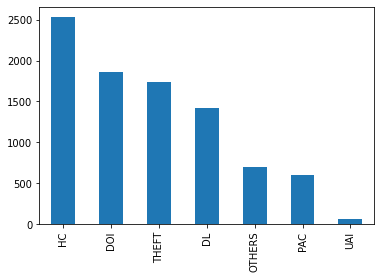

In [37]:
import matplotlib.pyplot as plt
df3['INCIBE TAXONOMY'].value_counts().plot.bar()
plt.show()

# Vectorizacion

In [38]:
X = df3[['desp_clean_final']]
Y = df3[['INCIBE TAXONOMY']]

In [39]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(X, Y,test_size=0.30, random_state=500)

In [40]:
print(len(x_train))
print(len(x_test))

6242
2676


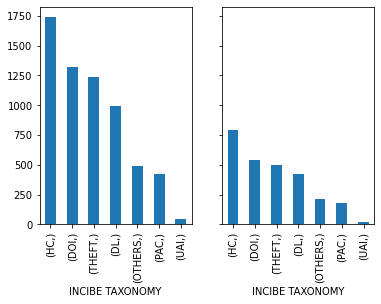

In [41]:
fig, axes = plt.subplots(1,2, sharey = True)
y_train.value_counts().plot.bar(ax = axes[0])
y_test.value_counts().plot.bar(ax = axes[1])

Vectorizar la descripción

In [42]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.pipeline import make_pipeline 

# Clasificado Naive Bayes

In [ ]:
x_train.shape

(6242, 1)

In [ ]:
y_train.shape

(6242, 1)

In [ ]:
model01 = make_pipeline(TfidfVectorizer(), MultinomialNB())

In [ ]:
model01.fit(x_train['desp_clean_final'], y_train['INCIBE TAXONOMY'])

Pipeline(steps=[('tfidfvectorizer', TfidfVectorizer()),
                ('multinomialnb', MultinomialNB())])

In [ ]:
ypred = model01.predict(x_test['desp_clean_final'])

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test['INCIBE TAXONOMY'],ypred))

              precision    recall  f1-score   support

          DL       0.77      0.84      0.80       426
         DOI       0.87      0.63      0.73       539
          HC       0.63      0.98      0.77       792
      OTHERS       0.99      0.79      0.88       216
         PAC       0.77      0.19      0.30       180
       THEFT       0.97      0.73      0.83       500
         UAI       0.00      0.00      0.00        23

    accuracy                           0.76      2676
   macro avg       0.71      0.59      0.62      2676
weighted avg       0.80      0.76      0.75      2676



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
print(ypred[1:1000])

['HC' 'HC' 'HC' 'HC' 'HC' 'PAC' 'HC' 'HC' 'DL' 'HC' 'OTHERS' 'HC' 'DOI'
 'DOI' 'HC' 'THEFT' 'HC' 'THEFT' 'DL' 'DL' 'HC' 'HC' 'HC' 'DL' 'HC' 'HC'
 'DL' 'DL' 'HC' 'HC' 'HC' 'HC' 'HC' 'HC' 'HC' 'HC' 'DL' 'DOI' 'HC' 'HC'
 'DL' 'HC' 'DOI' 'THEFT' 'DL' 'DOI' 'THEFT' 'HC' 'HC' 'HC' 'HC' 'HC' 'HC'
 'DOI' 'HC' 'PAC' 'DL' 'DL' 'HC' 'THEFT' 'DOI' 'DL' 'HC' 'HC' 'HC' 'DOI'
 'DOI' 'DOI' 'HC' 'DL' 'HC' 'THEFT' 'HC' 'HC' 'HC' 'DOI' 'HC' 'DOI' 'HC'
 'DL' 'HC' 'DL' 'HC' 'HC' 'HC' 'HC' 'HC' 'HC' 'HC' 'DOI' 'HC' 'HC' 'HC'
 'THEFT' 'HC' 'HC' 'THEFT' 'HC' 'THEFT' 'DL' 'DOI' 'DOI' 'HC' 'HC' 'DOI'
 'DL' 'HC' 'HC' 'HC' 'HC' 'DL' 'OTHERS' 'HC' 'OTHERS' 'THEFT' 'DOI' 'DOI'
 'HC' 'HC' 'HC' 'HC' 'DOI' 'DOI' 'DL' 'HC' 'HC' 'DL' 'THEFT' 'THEFT' 'HC'
 'HC' 'HC' 'DOI' 'HC' 'HC' 'THEFT' 'OTHERS' 'OTHERS' 'THEFT' 'HC' 'HC'
 'HC' 'DL' 'OTHERS' 'THEFT' 'HC' 'DL' 'HC' 'HC' 'HC' 'DOI' 'OTHERS' 'HC'
 'DL' 'DL' 'THEFT' 'DOI' 'THEFT' 'DOI' 'HC' 'DL' 'DL' 'HC' 'HC' 'DL' 'HC'
 'HC' 'HC' 'DL' 'DL' 'HC' 'HC' 'DL' 'HC' 'HC' 'HC' '

# Baseline

Cual es el punto de partida

Clase más frecuente

In [ ]:
print(classification_report(y_test['INCIBE TAXONOMY'], ['HC']*y_test.shape[0]))

              precision    recall  f1-score   support

          DL       0.00      0.00      0.00       426
         DOI       0.00      0.00      0.00       539
          HC       0.30      1.00      0.46       792
      OTHERS       0.00      0.00      0.00       216
         PAC       0.00      0.00      0.00       180
       THEFT       0.00      0.00      0.00       500
         UAI       0.00      0.00      0.00        23

    accuracy                           0.30      2676
   macro avg       0.04      0.14      0.07      2676
weighted avg       0.09      0.30      0.14      2676



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


# Balanceo de datos

In [ ]:
minimo = df3['INCIBE TAXONOMY'].value_counts().min()
subset = []

In [ ]:
labels

['DL', 'DOI', 'HC', 'OTHERS', 'PAC', 'THEFT', 'UAI']

In [ ]:
# Una mascara
df3.loc[df3['INCIBE TAXONOMY'] == 'DL']

,Description of incident,INCIBE TAXONOMY,Description_lower,description_clean,data_tokenized,Description_no_stpw,Description stemmend,Description lemmatized,desp_clean_final
1,"The December 29, 2011 theft of a laptop from a parked car in San Francisco resulted in the loss of personal information. The information was being used in preparation for a merger between SF Fire Credit Union and Pacifica-Coastside Credit Union. Current and former account holders had their names, Social Security numbers, dates of birth, addresses, and Pacifica-Coastside Credit Union account information.",DL,"the december 29, 2011 theft of a laptop from a parked car in san francisco resulted in the loss of personal information. the information was being used in preparation for a merger between sf fire credit union and pacifica-coastside credit union. current and former account holders had their names, social security numbers, dates of birth, addresses, and pacifica-coastside credit union account information.",the december 29 2011 theft of a laptop from a parked car in san francisco resulted in the loss of personal information the information was being used in preparation for a merger between sf fire credit union and pacificacoastside credit union current and former account holders had their names social security numbers dates of birth addresses and pacificacoastside credit union account information,"[the, december, 29, 2011, theft, of, a, laptop, from, a, parked, car, in, san, francisco, resulted, in, the, loss, of, personal, information, the, information, was, being, used, in, preparation, for, a, merger, between, sf, fire, credit, union, and, pacificacoastside, credit, union, current, and, former, account, holders, had, their, names, social, security, numbers, dates, of, birth, addresses, and, pacificacoastside, credit, union, account, information]","[the, december, 29, 2011, theft, of, a, laptop, from, a, parked, car, in, san, francisco, resulted, in, the, loss, of, personal, information, the, information, was, being, used, in, preparation, for, a, merger, between, sf, fire, credit, union, and, pacificacoastside, credit, union, current, and, former, account, holders, had, their, names, social, security, numbers, dates, of, birth, addresses, and, pacificacoastside, credit, union, account, information]","[the, decemb, 29, 2011, theft, of, a, laptop, from, a, park, car, in, san, francisco, result, in, the, loss, of, person, inform, the, inform, wa, be, use, in, prepar, for, a, merger, between, sf, fire, credit, union, and, pacificacoastsid, credit, union, current, and, former, account, holder, had, their, name, social, secur, number, date, of, birth, address, and, pacificacoastsid, credit, union, account, inform]","[the, december, 29, 2011, theft, of, a, laptop, from, a, parked, car, in, san, francisco, resulted, in, the, loss, of, personal, information, the, information, wa, being, used, in, preparation, for, a, merger, between, sf, fire, credit, union, and, pacificacoastside, credit, union, current, and, former, account, holder, had, their, name, social, security, number, date, of, birth, address, and, pacificacoastside, credit, union, account, information]",decemb 29 2011 theft laptop park car san francisco result loss person inform inform use prepar merger sf fire credit union pacificacoastsid credit union current former account holder name social secur number date birth address pacificacoastsid credit union account inform
2,"BDO was contracted by Rubio's to perform financial auditing services. A BDO employee accidentally removed one or more CD-ROMs from the office. The CD-ROM or CD-ROMs contained a list of Rubio's workers' compensation claimants and a list of people who owned equity shares in Rubio's Restaurants, Inc. The CD-ROM or CD-ROMS appear to have been stolen from the BDO employee's vehicle. The workers' compensation information contained names, claim numbers, medical status, and date of loss. The medical status information included the employ

In [ ]:
import numpy as np
for label in labels:
  indices = df3.loc[df3['INCIBE TAXONOMY']==label].index
  ranind = np.random.choice(indices,
                            size=minimo,
                            replace=False)
  subset.append(df3.loc[ranind,:])

In [ ]:
type (subset)

list

In [ ]:
df4 = pd.concat(subset)

In [ ]:
df4.head()

,Description of incident,INCIBE TAXONOMY,Description_lower,description_clean,data_tokenized,Description_no_stpw,Description stemmend,Description lemmatized,desp_clean_final
6631,"A laptop computer containing Social Security Numbers and other personal information was stolen from a car outside an employee's home on Oct. 20. The billing information on the computer was password-protected, but an analysis found it was possible to decode the security controls on the laptop and gain access to the personal information.",DL,"a laptop computer containing social security numbers and other personal information was stolen from a car outside an employee's home on oct. 20. the billing information on the computer was password-protected, but an analysis found it was possible to decode the security controls on the laptop and gain access to the personal information.",a laptop computer containing social security numbers and other personal information was stolen from a car outside an employees home on oct 20 the billing information on the computer was passwordprotected but an analysis found it was possible to decode the security controls on the laptop and gain access to the personal information,"[a, laptop, computer, containing, social, security, numbers, and, other, personal, information, was, stolen, from, a, car, outside, an, employees, home, on, oct, 20, the, billing, information, on, the, computer, was, passwordprotected, but, an, analysis, found, it, was, possible, to, decode, the, security, controls, on, the, laptop, and, gain, access, to, the, personal, information]","[a, laptop, computer, containing, social, security, numbers, and, other, personal, information, was, stolen, from, a, car, outside, an, employees, home, on, oct, 20, the, billing, information, on, the, computer, was, passwordprotected, but, an, analysis, found, it, was, possible, to, decode, the, security, controls, on, the, laptop, and, gain, access, to, the, personal, information]","[a, laptop, comput, contain, social, secur, number, and, other, person, inform, wa, stolen, from, a, car, outsid, an, employe, home, on, oct, 20, the, bill, inform, on, the, comput, wa, passwordprotect, but, an, analysi, found, it, wa, possibl, to, decod, the, secur, control, on, the, laptop, and, gain, access, to, the, person, inform]","[a, laptop, computer, containing, social, security, number, and, other, personal, information, wa, stolen, from, a, car, outside, an, employee, home, on, oct, 20, the, billing, information, on, the, computer, wa, passwordprotected, but, an, analysis, found, it, wa, possible, to, decode, the, security, control, on, the, laptop, and, gain, access, to, the, personal, information]",laptop comput contain social secur number person inform stolen car outsid employe home oct 20 bill inform comput passwordprotect analysi found possibl decod secur control laptop gain access person inform
7175,"""A business associate (BA), Seim Johnson, LLP, reported on behalf of 10 health care provider clients that its health care auditor took his firm-issued laptop computer on a non-business weekend trip. When the employee arrived home from this trip, he discovered the backpack containing the laptop was missing. The laptop contained the protected health information (PHI) of 30,972 individuals and included demographic, clinical, and financial information. The BA provided breach notification to HHS, affected individuals, and the media. After investigating this incident, the BA determined that the laptop may not have been effectively encrypted. Following the breach, the BA sanctioned the involved employee and its security officer, retrained employees on security risks involving portable devices, and implemented new policies and procedures. OCR obtained assurances that the BA implemented the corrective actions listed above.""More Information: https://ocrportal.hhs.gov/ocr/breach/breach_report.jsf;jsessionid=9BF4AF...",DL,"""a business associate (ba), seim johnson, llp, reported on behalf of 

In [ ]:
df4 = df4.reset_index(drop=True)
df4.head()

,Description of incident,INCIBE TAXONOMY,Description_lower,description_clean,data_tokenized,Description_no_stpw,Description stemmend,Description lemmatized,desp_clean_final
0,"A laptop computer containing Social Security Numbers and other personal information was stolen from a car outside an employee's home on Oct. 20. The billing information on the computer was password-protected, but an analysis found it was possible to decode the security controls on the laptop and gain access to the personal information.",DL,"a laptop computer containing social security numbers and other personal information was stolen from a car outside an employee's home on oct. 20. the billing information on the computer was password-protected, but an analysis found it was possible to decode the security controls on the laptop and gain access to the personal information.",a laptop computer containing social security numbers and other personal information was stolen from a car outside an employees home on oct 20 the billing information on the computer was passwordprotected but an analysis found it was possible to decode the security controls on the laptop and gain access to the personal information,"[a, laptop, computer, containing, social, security, numbers, and, other, personal, information, was, stolen, from, a, car, outside, an, employees, home, on, oct, 20, the, billing, information, on, the, computer, was, passwordprotected, but, an, analysis, found, it, was, possible, to, decode, the, security, controls, on, the, laptop, and, gain, access, to, the, personal, information]","[a, laptop, computer, containing, social, security, numbers, and, other, personal, information, was, stolen, from, a, car, outside, an, employees, home, on, oct, 20, the, billing, information, on, the, computer, was, passwordprotected, but, an, analysis, found, it, was, possible, to, decode, the, security, controls, on, the, laptop, and, gain, access, to, the, personal, information]","[a, laptop, comput, contain, social, secur, number, and, other, person, inform, wa, stolen, from, a, car, outsid, an, employe, home, on, oct, 20, the, bill, inform, on, the, comput, wa, passwordprotect, but, an, analysi, found, it, wa, possibl, to, decod, the, secur, control, on, the, laptop, and, gain, access, to, the, person, inform]","[a, laptop, computer, containing, social, security, number, and, other, personal, information, wa, stolen, from, a, car, outside, an, employee, home, on, oct, 20, the, billing, information, on, the, computer, wa, passwordprotected, but, an, analysis, found, it, wa, possible, to, decode, the, security, control, on, the, laptop, and, gain, access, to, the, personal, information]",laptop comput contain social secur number person inform stolen car outsid employe home oct 20 bill inform comput passwordprotect analysi found possibl decod secur control laptop gain access person inform
1,"""A business associate (BA), Seim Johnson, LLP, reported on behalf of 10 health care provider clients that its health care auditor took his firm-issued laptop computer on a non-business weekend trip. When the employee arrived home from this trip, he discovered the backpack containing the laptop was missing. The laptop contained the protected health information (PHI) of 30,972 individuals and included demographic, clinical, and financial information. The BA provided breach notification to HHS, affected individuals, and the media. After investigating this incident, the BA determined that the laptop may not have been effectively encrypted. Following the breach, the BA sanctioned the involved employee and its security officer, retrained employees on security risks involving portable devices, and implemented new policies and procedures. OCR obtained assurances that the BA implemented the corrective actions listed above.""More Information: https://ocrportal.hhs.gov/ocr/breach/breach_report.jsf;jsessionid=9BF4AF...",DL,"""a business associate (ba), seim johnson, llp, reported on behalf of 10 hea

In [ ]:
df4['INCIBE TAXONOMY'].value_counts()

DL        68
DOI       68
HC        68
OTHERS    68
PAC       68
THEFT     68
UAI       68
Name: INCIBE TAXONOMY, dtype: int64

In [ ]:
print(len(df4))

476


In [ ]:
X1 = df4[['desp_clean_final']]
Y1 = df4[['INCIBE TAXONOMY']]

In [ ]:
from sklearn.model_selection import train_test_split
x_train1, x_test1, y_train1, y_test1 = train_test_split(X1, Y1,test_size=0.2, random_state=500)

In [ ]:
print(len(x_train1))
print(len(x_test1))

380
96


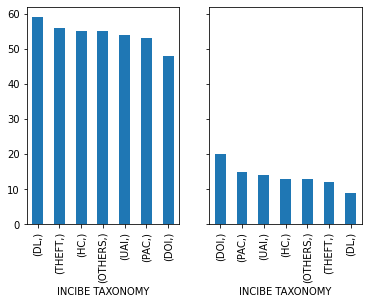

In [ ]:
fig, axes = plt.subplots(1,2, sharey = True)
y_train1.value_counts().plot.bar(ax = axes[0])
y_test1.value_counts().plot.bar(ax = axes[1])

In [ ]:
model01.fit(x_train1['desp_clean_final'],
          y_train1['INCIBE TAXONOMY'])

Pipeline(steps=[('tfidfvectorizer', TfidfVectorizer()),
                ('multinomialnb', MultinomialNB())])

In [ ]:
ypred1 = model01.predict(x_test1['desp_clean_final'])

In [ ]:
print(ypred1[1:100])

['PAC' 'UAI' 'DOI' 'UAI' 'DL' 'DL' 'THEFT' 'DL' 'UAI' 'UAI' 'HC' 'PAC'
 'OTHERS' 'DL' 'PAC' 'UAI' 'DL' 'DL' 'OTHERS' 'UAI' 'THEFT' 'OTHERS' 'DL'
 'PAC' 'UAI' 'UAI' 'DL' 'OTHERS' 'DL' 'HC' 'OTHERS' 'OTHERS' 'UAI' 'UAI'
 'PAC' 'HC' 'UAI' 'HC' 'PAC' 'DOI' 'UAI' 'DOI' 'DL' 'DL' 'DL' 'THEFT'
 'PAC' 'OTHERS' 'THEFT' 'HC' 'UAI' 'OTHERS' 'THEFT' 'PAC' 'DOI' 'DOI'
 'UAI' 'PAC' 'UAI' 'THEFT' 'PAC' 'UAI' 'HC' 'DL' 'HC' 'DOI' 'DL' 'PAC'
 'DL' 'DOI' 'DL' 'HC' 'DL' 'HC' 'HC' 'DOI' 'OTHERS' 'PAC' 'HC' 'UAI' 'DOI'
 'PAC' 'HC' 'UAI' 'HC' 'HC' 'DL' 'DL' 'OTHERS' 'PAC' 'DL' 'HC' 'DL' 'PAC'
 'HC']


In [ ]:
print(classification_report(y_test1['INCIBE TAXONOMY'],
                            ypred1))

              precision    recall  f1-score   support

          DL       0.43      1.00      0.60         9
         DOI       1.00      0.45      0.62        20
          HC       0.59      0.77      0.67        13
      OTHERS       1.00      0.77      0.87        13
         PAC       0.73      0.73      0.73        15
       THEFT       1.00      0.50      0.67        12
         UAI       0.61      0.79      0.69        14

    accuracy                           0.69        96
   macro avg       0.77      0.72      0.69        96
weighted avg       0.79      0.69      0.69        96



# Matriz de confusion

Text(33.0, 0.5, 'real')

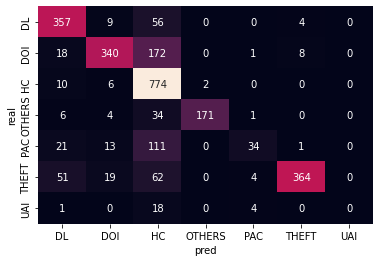

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

mat = confusion_matrix(y_test['INCIBE TAXONOMY'],ypred)
sns.heatmap(mat, 
            annot = True, 
            fmt = 'd',
            cbar = False,
            xticklabels = labels,
            yticklabels= labels)
plt.xlabel('pred')
plt.ylabel('real')

Text(33.0, 0.5, 'real')

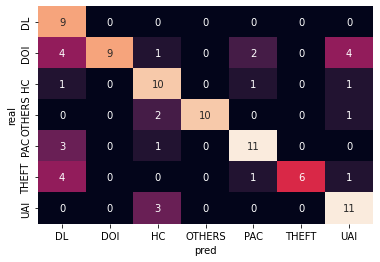

In [ ]:
mat1 = confusion_matrix(y_test1['INCIBE TAXONOMY'],ypred1)
sns.heatmap(mat1, 
            annot = True, 
            fmt = 'd',
            cbar = False,
            xticklabels = labels,
            yticklabels= labels)
plt.xlabel('pred')
plt.ylabel('real')

# GridSearchCV para NB

Parametros

Hiperparametros

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline

In [ ]:
model_01 = Pipeline(steps=[('tfidf', TfidfVectorizer()), ('bayes', MultinomialNB())])

In [ ]:
#model_01 = Pipeline(steps=[('countvectorizer', CountVectorizer()), ('bayes', MultinomialNB())])

In [ ]:
# params = {'countvectorizer__binary':(True,False),
   #       'countvectorizer__ngram_range':((1,1),(1,2)),
   #       'bayes__alpha': (0.1,0.5,1)} #smoothing: achica las diferencias

In [ ]:
params = {'tfidf__binary':(True,False),
          'tfidf__ngram_range':((1,1),(1,2)),
          'bayes__alpha': (0.1,0.5,1)} #smoothing: achica las diferencias

In [ ]:
grid = GridSearchCV(model_01,params,cv=5)
#crossvalidatin (cv) (un dedo de testeo y el resto de entrenamiento)
#help(GridSearchCV)

In [ ]:
grid.fit(x_train['desp_clean_final'], y_train['INCIBE TAXONOMY'])

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('tfidf', TfidfVectorizer()),
                                       ('bayes', MultinomialNB())]),
             param_grid={'bayes__alpha': (0.1, 0.5, 1),
                         'tfidf__binary': (True, False),
                         'tfidf__ngram_range': ((1, 1), (1, 2))})

In [ ]:
ypred2 = grid.predict(x_test['desp_clean_final'])

In [ ]:
print(classification_report(y_test['INCIBE TAXONOMY'],ypred2))

              precision    recall  f1-score   support

          DL       0.73      0.88      0.80       426
         DOI       0.84      0.75      0.79       539
          HC       0.77      0.94      0.84       792
      OTHERS       0.98      0.79      0.87       216
         PAC       0.76      0.57      0.65       180
       THEFT       0.96      0.78      0.86       500
         UAI       1.00      0.04      0.08        23

    accuracy                           0.82      2676
   macro avg       0.86      0.68      0.70      2676
weighted avg       0.83      0.82      0.81      2676



Text(33.0, 0.5, 'real')

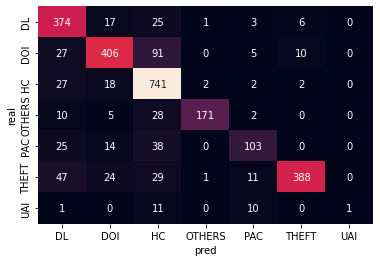

In [ ]:
mat2 = confusion_matrix(y_test['INCIBE TAXONOMY'],ypred2)
sns.heatmap(mat2, 
            annot = True, 
            fmt = 'd',
            cbar = False,
            xticklabels = labels,
            yticklabels= labels)
plt.xlabel('pred')
plt.ylabel('real')

In [ ]:
grid.best_estimator_

Pipeline(steps=[('tfidf', TfidfVectorizer()),
                ('bayes', MultinomialNB(alpha=0.1))])

# Clasificador Regresión Logistica

In [43]:
from sklearn.linear_model import LogisticRegression

In [44]:
model02 = make_pipeline(TfidfVectorizer(), LogisticRegression(class_weight="balanced"))

In [ ]:
#model02 = make_pipeline(CountVectorizer(), LogisticRegression())

In [45]:
model02.fit(x_train['desp_clean_final'], y_train['INCIBE TAXONOMY'])

Pipeline(steps=[('tfidfvectorizer', TfidfVectorizer()),
                ('logisticregression',
                 LogisticRegression(class_weight='balanced'))])

In [46]:
ypred02 = model02.predict(x_test['desp_clean_final'])

In [47]:
from sklearn.metrics import classification_report
print(classification_report(y_test['INCIBE TAXONOMY'],ypred02))

              precision    recall  f1-score   support

          DL       0.83      0.86      0.84       426
         DOI       0.80      0.83      0.82       539
          HC       0.89      0.87      0.88       792
      OTHERS       0.97      0.82      0.89       216
         PAC       0.61      0.79      0.69       180
       THEFT       0.94      0.83      0.88       500
         UAI       0.49      0.78      0.60        23

    accuracy                           0.85      2676
   macro avg       0.79      0.83      0.80      2676
weighted avg       0.86      0.85      0.85      2676



In [48]:
print(ypred02[1:1000])

['HC' 'HC' 'HC' 'PAC' 'HC' 'PAC' 'HC' 'HC' 'DL' 'DOI' 'OTHERS' 'HC' 'DOI'
 'DOI' 'PAC' 'THEFT' 'HC' 'THEFT' 'DL' 'DL' 'HC' 'HC' 'UAI' 'DL' 'DOI'
 'HC' 'PAC' 'DL' 'HC' 'HC' 'HC' 'DOI' 'HC' 'HC' 'UAI' 'HC' 'DL' 'THEFT'
 'HC' 'HC' 'DL' 'HC' 'DOI' 'THEFT' 'DL' 'DOI' 'THEFT' 'DOI' 'HC' 'HC' 'HC'
 'HC' 'PAC' 'DOI' 'PAC' 'PAC' 'DL' 'DL' 'PAC' 'THEFT' 'DOI' 'THEFT' 'HC'
 'HC' 'UAI' 'PAC' 'DOI' 'DOI' 'UAI' 'DL' 'DOI' 'THEFT' 'HC' 'HC' 'DOI'
 'DOI' 'DOI' 'DOI' 'HC' 'DL' 'HC' 'DL' 'HC' 'HC' 'HC' 'HC' 'HC' 'DOI'
 'PAC' 'DOI' 'DL' 'PAC' 'HC' 'THEFT' 'HC' 'HC' 'THEFT' 'HC' 'THEFT' 'DL'
 'PAC' 'DOI' 'HC' 'HC' 'DOI' 'PAC' 'HC' 'HC' 'HC' 'HC' 'DL' 'OTHERS' 'DOI'
 'OTHERS' 'THEFT' 'DOI' 'DOI' 'HC' 'HC' 'HC' 'HC' 'DOI' 'DOI' 'DL' 'HC'
 'DOI' 'DL' 'THEFT' 'THEFT' 'DOI' 'HC' 'DOI' 'DOI' 'HC' 'DOI' 'THEFT'
 'OTHERS' 'OTHERS' 'THEFT' 'PAC' 'HC' 'HC' 'DL' 'OTHERS' 'THEFT' 'DOI'
 'DL' 'HC' 'HC' 'HC' 'DOI' 'OTHERS' 'DL' 'DL' 'DL' 'THEFT' 'DOI' 'THEFT'
 'THEFT' 'HC' 'DL' 'DL' 'DOI' 'HC' 'DL' 'DOI' 'THEFT' 'PAC' 

Text(33.0, 0.5, 'real')

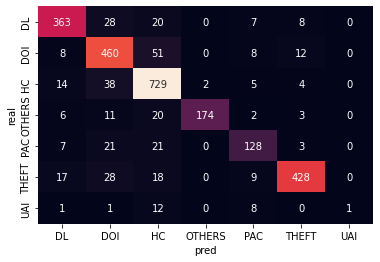

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

mat_lgr = confusion_matrix(y_test['INCIBE TAXONOMY'],ypred02)
sns.heatmap(mat_lgr, 
            annot = True, 
            fmt = 'd',
            cbar = False,
            xticklabels = labels,
            yticklabels= labels)
plt.xlabel('pred')
plt.ylabel('real')

# Clasificador SVM

In [ ]:
from sklearn.svm import SVC
from sklearn import svm

In [ ]:
#model03 = make_pipeline(CountVectorizer(),  svm.SVC(kernel="linear"))

In [ ]:
model03 = make_pipeline(TfidfVectorizer(),  svm.SVC(kernel="linear"))

In [ ]:
model03.fit(x_train['desp_clean_final'], y_train['INCIBE TAXONOMY'])

Pipeline(steps=[('tfidfvectorizer', TfidfVectorizer()),
                ('svc', SVC(kernel='linear'))])

In [ ]:
ypred03 = model03.predict(x_test['desp_clean_final'])

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test['INCIBE TAXONOMY'],ypred03))

              precision    recall  f1-score   support

          DL       0.88      0.84      0.86       426
         DOI       0.76      0.86      0.81       539
          HC       0.85      0.91      0.88       792
      OTHERS       0.99      0.81      0.89       216
         PAC       0.79      0.74      0.76       180
       THEFT       0.92      0.86      0.89       500
         UAI       0.88      0.30      0.45        23

    accuracy                           0.85      2676
   macro avg       0.87      0.76      0.79      2676
weighted avg       0.86      0.85      0.85      2676



In [ ]:
print(ypred03[1:1000])

['HC' 'HC' 'HC' 'PAC' 'HC' 'PAC' 'HC' 'HC' 'DL' 'DOI' 'OTHERS' 'HC' 'DOI'
 'DOI' 'HC' 'THEFT' 'HC' 'THEFT' 'DL' 'DL' 'HC' 'HC' 'HC' 'DL' 'DOI' 'HC'
 'PAC' 'DL' 'HC' 'HC' 'HC' 'DOI' 'HC' 'HC' 'UAI' 'HC' 'DL' 'THEFT' 'HC'
 'DL' 'DL' 'HC' 'DOI' 'THEFT' 'DL' 'DOI' 'THEFT' 'DOI' 'HC' 'HC' 'HC' 'HC'
 'DOI' 'DOI' 'PAC' 'PAC' 'DL' 'THEFT' 'PAC' 'THEFT' 'DOI' 'THEFT' 'HC'
 'HC' 'HC' 'DOI' 'DOI' 'DOI' 'UAI' 'DL' 'DOI' 'THEFT' 'HC' 'HC' 'DOI'
 'DOI' 'HC' 'DOI' 'HC' 'DL' 'HC' 'DOI' 'HC' 'HC' 'HC' 'HC' 'DOI' 'DOI'
 'HC' 'DOI' 'DL' 'DOI' 'HC' 'THEFT' 'HC' 'HC' 'THEFT' 'HC' 'THEFT' 'DL'
 'DOI' 'DOI' 'HC' 'HC' 'DOI' 'PAC' 'HC' 'HC' 'HC' 'HC' 'DL' 'OTHERS' 'DOI'
 'OTHERS' 'THEFT' 'DOI' 'DOI' 'HC' 'HC' 'HC' 'HC' 'DOI' 'DOI' 'DL' 'HC'
 'DOI' 'DL' 'THEFT' 'THEFT' 'DOI' 'HC' 'DOI' 'DOI' 'HC' 'DOI' 'THEFT'
 'OTHERS' 'OTHERS' 'THEFT' 'HC' 'HC' 'HC' 'DL' 'OTHERS' 'THEFT' 'DOI' 'DL'
 'HC' 'HC' 'HC' 'DOI' 'OTHERS' 'HC' 'DL' 'DL' 'THEFT' 'DOI' 'THEFT'
 'THEFT' 'HC' 'DL' 'THEFT' 'DOI' 'HC' 'DL' 'DOI' 'THEFT' 'PAC

Text(33.0, 0.5, 'real')

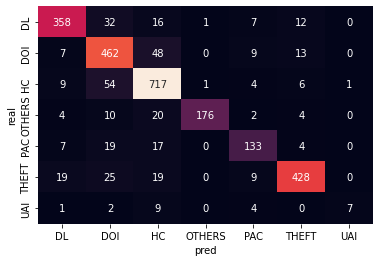

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

mat_SVM = confusion_matrix(y_test['INCIBE TAXONOMY'],ypred03)
sns.heatmap(mat_SVM, 
            annot = True, 
            fmt = 'd',
            cbar = False,
            xticklabels = labels,
            yticklabels= labels)
plt.xlabel('pred')
plt.ylabel('real')

# Clasificador Decision Tree

In [ ]:
from sklearn.tree import DecisionTreeClassifier

In [ ]:
model04 = make_pipeline(TfidfVectorizer(),  DecisionTreeClassifier())

In [ ]:
#model04 = make_pipeline(CountVectorizer(),  DecisionTreeClassifier())

In [ ]:
model04.fit(x_train['desp_clean_final'], y_train['INCIBE TAXONOMY'])

Pipeline(steps=[('tfidfvectorizer', TfidfVectorizer()),
                ('decisiontreeclassifier', DecisionTreeClassifier())])

In [ ]:
ypred04 = model04.predict(x_test['desp_clean_final'])

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test['INCIBE TAXONOMY'],ypred04))

              precision    recall  f1-score   support

          DL       0.76      0.78      0.77       426
         DOI       0.68      0.81      0.74       539
          HC       0.85      0.80      0.82       792
      OTHERS       0.83      0.82      0.83       216
         PAC       0.63      0.53      0.58       180
       THEFT       0.80      0.76      0.78       500
         UAI       0.33      0.30      0.32        23

    accuracy                           0.77      2676
   macro avg       0.70      0.68      0.69      2676
weighted avg       0.77      0.77      0.77      2676



In [ ]:
print(ypred04[1:1000])

['HC' 'THEFT' 'HC' 'DL' 'HC' 'THEFT' 'HC' 'HC' 'DL' 'DOI' 'OTHERS' 'HC'
 'DOI' 'DOI' 'DOI' 'THEFT' 'HC' 'THEFT' 'DL' 'HC' 'HC' 'HC' 'UAI' 'DL'
 'DOI' 'DOI' 'DL' 'DL' 'HC' 'HC' 'HC' 'DOI' 'HC' 'HC' 'DL' 'HC' 'DL'
 'THEFT' 'HC' 'DOI' 'DL' 'DOI' 'DOI' 'THEFT' 'DL' 'DOI' 'THEFT' 'HC' 'HC'
 'HC' 'HC' 'HC' 'HC' 'DOI' 'PAC' 'THEFT' 'DL' 'DL' 'DL' 'THEFT' 'DOI'
 'THEFT' 'DOI' 'DL' 'UAI' 'DOI' 'DOI' 'OTHERS' 'PAC' 'DL' 'DL' 'THEFT'
 'HC' 'DL' 'THEFT' 'DOI' 'HC' 'DOI' 'PAC' 'DL' 'HC' 'DL' 'HC' 'HC' 'HC'
 'HC' 'HC' 'HC' 'DOI' 'DOI' 'DL' 'DOI' 'HC' 'THEFT' 'PAC' 'HC' 'THEFT'
 'HC' 'THEFT' 'DL' 'THEFT' 'DOI' 'DOI' 'HC' 'DOI' 'PAC' 'HC' 'HC' 'HC'
 'HC' 'DL' 'OTHERS' 'DOI' 'OTHERS' 'THEFT' 'DOI' 'DOI' 'HC' 'HC' 'HC' 'HC'
 'DOI' 'DOI' 'DL' 'HC' 'DOI' 'DL' 'THEFT' 'THEFT' 'DOI' 'HC' 'THEFT' 'DOI'
 'DOI' 'HC' 'THEFT' 'OTHERS' 'OTHERS' 'THEFT' 'HC' 'HC' 'HC' 'DL' 'OTHERS'
 'THEFT' 'DOI' 'DL' 'HC' 'HC' 'HC' 'DOI' 'OTHERS' 'THEFT' 'DOI' 'DL'
 'THEFT' 'DOI' 'THEFT' 'THEFT' 'HC' 'DL' 'DL' 'THEFT' 'THEFT' 'DL

Text(33.0, 0.5, 'real')

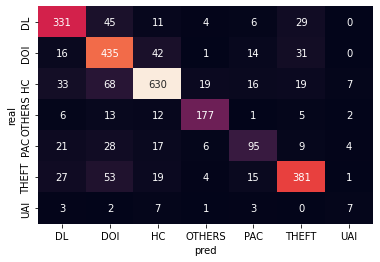

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

mat_DT = confusion_matrix(y_test['INCIBE TAXONOMY'],ypred04)
sns.heatmap(mat_DT, 
            annot = True, 
            fmt = 'd',
            cbar = False,
            xticklabels = labels,
            yticklabels= labels)
plt.xlabel('pred')
plt.ylabel('real')

# Clasificador KNN

In [ ]:
from sklearn import neighbors

In [ ]:
model05 = make_pipeline(TfidfVectorizer(),  neighbors.KNeighborsClassifier())

In [ ]:
#model05 = make_pipeline(CountVectorizer(),  neighbors.KNeighborsClassifier())

In [ ]:
model05.fit(x_train['desp_clean_final'], y_train['INCIBE TAXONOMY'])

Pipeline(steps=[('tfidfvectorizer', TfidfVectorizer()),
                ('kneighborsclassifier', KNeighborsClassifier())])

In [ ]:
ypred05 = model05.predict(x_test['desp_clean_final'])

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test['INCIBE TAXONOMY'],ypred05))

              precision    recall  f1-score   support

          DL       0.53      0.36      0.43       426
         DOI       0.35      0.78      0.49       539
          HC       0.67      0.40      0.50       792
      OTHERS       0.99      0.79      0.88       216
         PAC       0.40      0.01      0.02       180
       THEFT       0.63      0.68      0.65       500
         UAI       0.00      0.00      0.00        23

    accuracy                           0.53      2676
   macro avg       0.51      0.43      0.43      2676
weighted avg       0.58      0.53      0.51      2676



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
print(ypred05[1:1000])

['HC' 'DOI' 'DOI' 'HC' 'DOI' 'DOI' 'HC' 'DOI' 'DL' 'DOI' 'OTHERS' 'DOI'
 'DL' 'DOI' 'THEFT' 'THEFT' 'HC' 'THEFT' 'DOI' 'DOI' 'DOI' 'DOI' 'THEFT'
 'DOI' 'DOI' 'DOI' 'THEFT' 'DOI' 'HC' 'HC' 'DL' 'DOI' 'DOI' 'HC' 'DL' 'HC'
 'DL' 'DOI' 'DOI' 'HC' 'DOI' 'DOI' 'THEFT' 'THEFT' 'DL' 'DOI' 'THEFT'
 'THEFT' 'HC' 'DOI' 'HC' 'DOI' 'DOI' 'DOI' 'DL' 'HC' 'DL' 'DOI' 'THEFT'
 'DOI' 'THEFT' 'DL' 'THEFT' 'THEFT' 'THEFT' 'DOI' 'DL' 'DOI' 'HC' 'DOI'
 'DOI' 'THEFT' 'DL' 'HC' 'THEFT' 'DOI' 'DOI' 'DOI' 'HC' 'DL' 'THEFT' 'DL'
 'HC' 'HC' 'DOI' 'DOI' 'DOI' 'DOI' 'DOI' 'HC' 'DOI' 'THEFT' 'THEFT'
 'THEFT' 'DOI' 'DOI' 'THEFT' 'HC' 'THEFT' 'HC' 'DL' 'DOI' 'HC' 'DOI' 'DOI'
 'DOI' 'DOI' 'THEFT' 'DOI' 'DOI' 'DOI' 'OTHERS' 'THEFT' 'OTHERS' 'THEFT'
 'DOI' 'DOI' 'DOI' 'HC' 'DOI' 'DOI' 'DOI' 'DOI' 'THEFT' 'HC' 'DOI' 'DOI'
 'THEFT' 'THEFT' 'DOI' 'HC' 'DOI' 'DOI' 'THEFT' 'DOI' 'THEFT' 'OTHERS'
 'OTHERS' 'THEFT' 'THEFT' 'HC' 'DOI' 'DOI' 'OTHERS' 'THEFT' 'DL' 'DL' 'HC'
 'DL' 'HC' 'DOI' 'OTHERS' 'DOI' 'DOI' 'DOI' 'THEFT' 'DOI'

Text(33.0, 0.5, 'real')

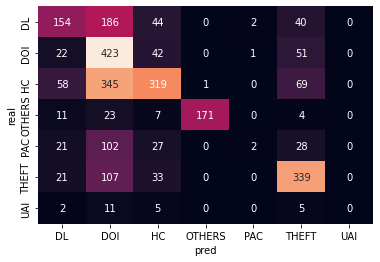

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

mat_KNN = confusion_matrix(y_test['INCIBE TAXONOMY'],ypred05)
sns.heatmap(mat_KNN, 
            annot = True, 
            fmt = 'd',
            cbar = False,
            xticklabels = labels,
            yticklabels= labels)
plt.xlabel('pred')
plt.ylabel('real')

# Clasificador MLP usando backpropagation

In [ ]:
from sklearn.neural_network import MLPClassifier

In [ ]:
#model06 = make_pipeline(TfidfVectorizer(), MLPClassifier(solver='adam', alpha=1e-5,hidden_layer_sizes=(25,), random_state=1))

In [ ]:
model06 = make_pipeline(TfidfVectorizer(), MLPClassifier(solver='lbfgs', alpha=1e-5,hidden_layer_sizes=(25,), random_state=1))

In [ ]:
#model06 = make_pipeline(TfidfVectorizer(), MLPClassifier(solver='sgd', alpha=1e-5,hidden_layer_sizes=(25,), random_state=1))

In [ ]:
#model06 = make_pipeline(CountVectorizer(), MLPClassifier(solver='lbfgs', alpha=1e-5,hidden_layer_sizes=(25,), random_state=1))

In [ ]:
#model06 = make_pipeline(CountVectorizer(), MLPClassifier(solver='sgd', alpha=1e-5,hidden_layer_sizes=(25,), random_state=1))

In [ ]:
#model06 = make_pipeline(CountVectorizer(), MLPClassifier(solver='adam', alpha=1e-5,hidden_layer_sizes=(25,), random_state=1))

In [ ]:
model06.fit(x_train['desp_clean_final'], y_train['INCIBE TAXONOMY'])

In [ ]:
ypred06 = model06.predict(x_test['desp_clean_final'])

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test['INCIBE TAXONOMY'],ypred06))

              precision    recall  f1-score   support

          DL       0.85      0.83      0.84       426
         DOI       0.73      0.81      0.77       539
          HC       0.85      0.85      0.85       792
      OTHERS       0.90      0.81      0.86       216
         PAC       0.69      0.69      0.69       180
       THEFT       0.86      0.84      0.85       500
         UAI       0.67      0.35      0.46        23

    accuracy                           0.82      2676
   macro avg       0.79      0.74      0.76      2676
weighted avg       0.82      0.82      0.82      2676



Text(33.0, 0.5, 'real')

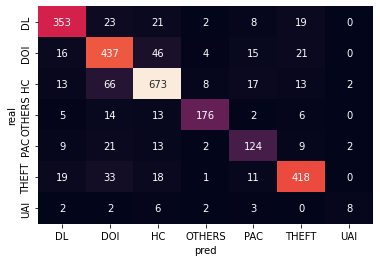

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

mat_MLP = confusion_matrix(y_test['INCIBE TAXONOMY'],ypred06)
sns.heatmap(mat_MLP, 
            annot = True, 
            fmt = 'd',
            cbar = False,
            xticklabels = labels,
            yticklabels= labels)
plt.xlabel('pred')
plt.ylabel('real')

In [ ]:
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import svm
from sklearn.tree import DecisionTreeClassifier
from sklearn import neighbors
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import cross_val_score

In [ ]:
models =[MultinomialNB(),LogisticRegression(),svm.SVC(kernel="linear"),DecisionTreeClassifier(),neighbors.KNeighborsClassifier(), MLPClassifier(solver='lbfgs', alpha=1e-5,hidden_layer_sizes=(25,), random_state=1)]
CV=5
cv_df = pd.DataFrame(index=range(CV*len(models)))
entries=[]

In [ ]:
for model in models:
  model_name = model.__class__.__name__
  accuracies = cross_val_score(model,labels,scoring='accuracy',cv=CV)

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 5.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 678, in _fit_and_score
    estimator.fit(X_train, **fit_params)
TypeError: fit() missing 1 required positional argument: 'y'

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 5.
The score on these train-test partitions for these parameters will be s

In [ ]:
for fold_idx, accuracy in enumerate(accuracies):
  entries.append((model_name,fold_idx, accuracy))

In [ ]:
cv_df = pd.DataFrame(entries,columns=['model_name','fold_idx','accuracy'])

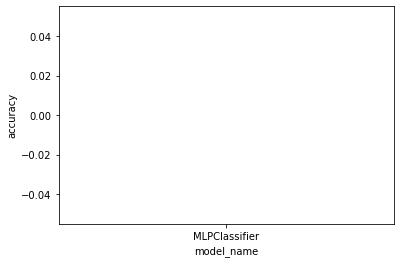

In [ ]:
import seaborn as sns
sns.boxplot(x='model_name',y='accuracy',data=cv_df)
sns.stripplot(x='model_name', y = 'accuracy',data = cv_df,size=8,jitter=True,edgecolor="gray",linewidth=2)
plt.show()

In [ ]:
cv_df.groupby('model_name').accuracy.mean()

model_name
MLPClassifier   NaN
Name: accuracy, dtype: float64